# TSNE Analysis

In [60]:
import pandas as pd
import numpy as np
from time import time
from sklearn.manifold import TSNE
from matplotlib import offsetbox
import matplotlib.pyplot as plt
from sklearn import datasets
import matplotlib.patches as mpatches
import cv2
import glob
import os
%matplotlib inline

In [61]:
#Taken from http://scikit-learn.org/stable/auto_examples/manifold/plot_lle_digits.html#sphx-glr-auto-examples-manifold-plot-lle-digits-py
#With some little modifications made by me.

# Authors: Fabian Pedregosa <fabian.pedregosa@inria.fr>
#          Olivier Grisel <olivier.grisel@ensta.org>
#          Mathieu Blondel <mathieu@mblondel.org>
#          Gael Varoquaux
# License: BSD 3 clause (C) INRIA 2011
def plot_embedding(X,n_samples,Y,plot_title,print_pictures=True,print_values=True):
    x_min, x_max = np.min(X, 0), np.max(X, 0)
    X = (X - x_min) / (x_max - x_min)

    plt.figure(figsize=[50,50])
    ax = plt.subplot(111)
    if print_values:
        for i in range(X.shape[0]):
            if Y[i]==1:
                plt.text(X[i, 0], X[i, 1], str(Y[i]),color=plt.cm.Set1(1),fontdict={'weight': 'bold', 'size': 30})
            elif Y[i]==1.5:
                plt.text(X[i, 0], X[i, 1], str(Y[i]),color=plt.cm.Set1(1),fontdict={'weight': 'bold', 'size': 30})
            elif Y[i]==2:
                plt.text(X[i, 0], X[i, 1], str(Y[i]),color=plt.cm.Set1(2),fontdict={'weight': 'bold', 'size': 30})
            elif Y[i]==2.5:
                plt.text(X[i, 0], X[i, 1], str(Y[i]),color=plt.cm.Set1(2),fontdict={'weight': 'bold', 'size': 30})
            elif Y[i]==3:
                plt.text(X[i, 0], X[i, 1], str(Y[i]),color=plt.cm.Set2(5),fontdict={'weight': 'bold', 'size': 30})
            elif Y[i]==3.5:
                plt.text(X[i, 0], X[i, 1], str(Y[i]),color=plt.cm.Set2(5),fontdict={'weight': 'bold', 'size': 30})
            elif Y[i]==4:
                plt.text(X[i, 0], X[i, 1], str(Y[i]),color=plt.cm.Set1(4),fontdict={'weight': 'bold', 'size': 30})
            elif Y[i]==4.5:
                plt.text(X[i, 0], X[i, 1], str(Y[i]),color=plt.cm.Set1(4),fontdict={'weight': 'bold', 'size': 30})
            elif Y[i]==5:
                plt.text(X[i, 0], X[i, 1], str(Y[i]),color=plt.cm.Set1(0),fontdict={'weight': 'bold', 'size': 30})
            elif Y[i]==5.5:
                plt.text(X[i, 0], X[i, 1], str(Y[i]),color=plt.cm.Set1(0),fontdict={'weight': 'bold', 'size': 30})
            elif Y[i]==6:
                plt.text(X[i, 0], X[i, 1], str(Y[i]),color=plt.cm.tab20b(16),fontdict={'weight': 'bold', 'size': 30})
            elif Y[i]==6.5:
                plt.text(X[i, 0], X[i, 1], str(Y[i]),color=plt.cm.tab20b(16),fontdict={'weight': 'bold', 'size': 30})
            elif Y[i]==7.0:
                plt.text(X[i, 0], X[i, 1], str(Y[i]),color=plt.cm.tab20b(12),fontdict={'weight': 'bold', 'size': 30})
    if print_pictures:
        if hasattr(offsetbox, 'AnnotationBbox'):
            shown_images = np.array([[1, 1]])
            for i in range(n_samples):
                dist = np.sum((X[i] - shown_images) ** 2, 1)
                if np.min(dist) < 4e-5:
                    continue
                shown_images = np.r_[shown_images, [X[i]]]
                imagebox = offsetbox.AnnotationBbox(offsetbox.OffsetImage(RGB_pictures_order[i]),X[i])
                ax.add_artist(imagebox)
    p1 = mpatches.Patch(color=plt.cm.Set1(1), label='1.0-1.5')
    p2 = mpatches.Patch(color=plt.cm.Set1(2), label='2.0-2.5')
    p3 = mpatches.Patch(color=plt.cm.Set2(5), label='3.0-3.5')
    p4 = mpatches.Patch(color=plt.cm.Set1(4), label='4.0-4.5')
    p5 = mpatches.Patch(color=plt.cm.Set1(0), label='5.0-5.5')
    p6 = mpatches.Patch(color=plt.cm.tab20b(16), label='6.0-6.5')
    p7 = mpatches.Patch(color=plt.cm.tab20b(12), label='7.0')

    plt.legend(handles=[p1,p2,p3,p4,p5,p6,p7],prop={'size':30})
    plt.xticks([]), plt.yticks([])
    plt.title(plot_title,fontsize= 45)

In [62]:
dir_features_image_segmentation="/Users/lemr/Documents/EPFL/Segundo_Semestre/semester_project/scripts/datasets/city_img_feat2.csv"
dir_features_places205="/Users/lemr/Documents/EPFL/Segundo_Semestre/semester_project/scripts/datasets/googlenet_places205_for_python.csv"
dir_labels="/Users/lemr/Documents/EPFL/Segundo_Semestre/semester_project/scripts/datasets/all-places-all-labels-median-medina.csv"
img_dir = '/Users/lemr/Documents/EPFL/Segundo_Semestre/semester_project/city-image-corpus/'

In [54]:
#Getting RGB values of the pictures
pictures=[]
RGB_pictures=[]
for picture in glob.glob(img_dir+"*.jpg"):
    im=cv2.imread(picture)
    im=cv2.resize(im, (0,0), fx=0.075, fy=0.075) 
    RGB_pictures.append(cv2.cvtColor(im, cv2.COLOR_BGR2RGB))
    pictures.append(os.path.basename(picture))

In [63]:
#Getting the dataframe with the RGB values and the images name files so that we can merge them and have the correct order
df_rgb_pictures=pd.DataFrame(RGB_pictures)
df_pictures=pd.DataFrame(pictures)
df_pictures["RGB"]=df_rgb_pictures
df_pictures=df_pictures.rename(columns = {0:'img_id'})

# Applying TSNE on the different labels

##  <span style="color:red">Image segmentation (150 features)</span> 

In [65]:
#Getting features dataframe
X=pd.read_csv(dir_features_image_segmentation).drop(["id","feat_0"],axis=1)
n_samples, n_features=X.shape
#Getting labels dataframe
Y=pd.read_csv(dir_labels).drop(["city"],axis=1)
Y=Y.rename(columns = {'annotation':'img_id'})
labels=Y.columns
labels=labels[labels!="img_id"].tolist()
#Merging both datasets in base to the image file
df_merge=pd.merge(X,Y,on="img_id")
#Merging the latter with the dataframe with the RGB in order to have the correct order of pictures.
df_pictures_order=pd.merge(df_merge,df_pictures,on="img_id")
#Getting the list of RGB codes with the correct order
RGB_pictures_order=df_pictures_order["RGB"].tolist()

In [66]:
df_merge.head()

,img_id,feat_1,feat_2,feat_3,feat_4,feat_5,feat_6,feat_7,feat_8,feat_9,...,Pretty,Preserved,Accessible,Interesting,Picturesque,Wealthy,Quiet,Polluted,Pleasant,Happy
0,s_20140101_125134.jpg,0.007447,0.495103,0.075117,0.352118,0.000359,0.0,0.022035,0.002386,0.0,...,5.0,5.0,5.0,5.5,4.5,3.5,5.0,2.0,5.0,5.5
1,s_20140101_125419.jpg,0.000000,0.390094,0.314747,0.008074,0.000000,0.0,0.089085,0.000000,0.0,...,3.0,4.0,5.0,5.0,3.0,2.5,3.0,2.5,4.0,4.0
2,s_20140101_125819.jpg,0.000000,0.284519,0.148422,0.026618,0.030529,0.0,0.025390,0.000000,0.0,...,5.0,6.0,6.0,6.0,5.5,2.0,3.0,2.0,6.0,6.0
3,s_20140101_125835.jpg,0.000000,0.470173,0.035024,0.000000,0.000000,0.0,0.112055,0.000000,0.0,...,3.0,4.0,5.0,4.5,2.5,2.0,2.5,3.0,4.0,4.0
4,s_20140101_125939.jpg,0.006698,0.612354,0.063612,0.000000,0.002196,0.0,0.181298,0.000000,0.0,...,5.0,5.0,6.0,5.5,5.0,2.5,4.0,2.5,5.5,5.5


## <span style="color:blue">Plot of the pictures</span>

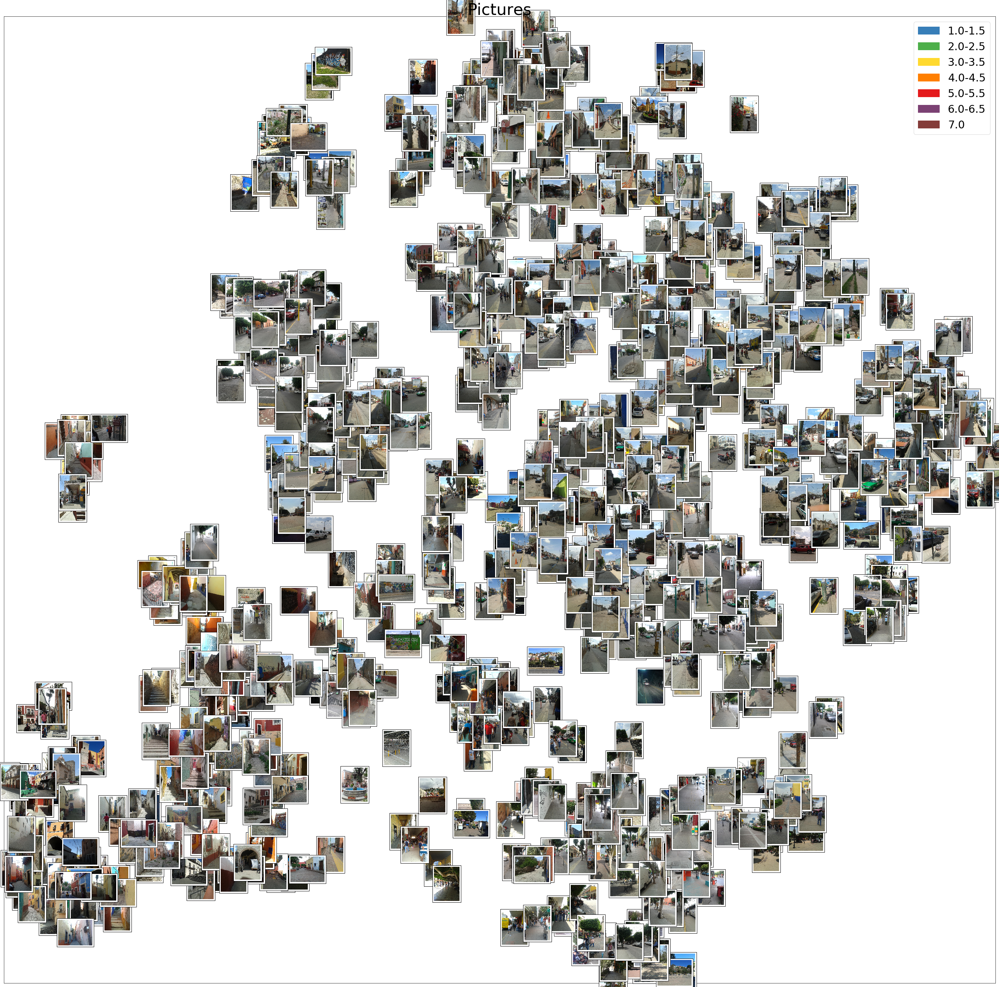

In [67]:
#Since the plot of the position of the different pictures is technically the same between the labels (however, the values will change), we can only plot it once
#Taking one random label to generate the plot with the pictures
label="Quiet"
#Applying TSNE
tsne = TSNE(n_components=2, random_state=0)
X_tsne = tsne.fit_transform(df_merge.drop(labels+["img_id"],axis=1))
#Plotting the pictures
plot_embedding(X_tsne,n_samples,df_merge[label],print_pictures=True,print_values=False,plot_title="Pictures")
#plt.show()
plt.savefig('/Users/lemr/Documents/EPFL/Segundo_Semestre/semester_project/scripts/tsne_analysis/tsne_image_segmentation_pictures.jpg')

## Polluted

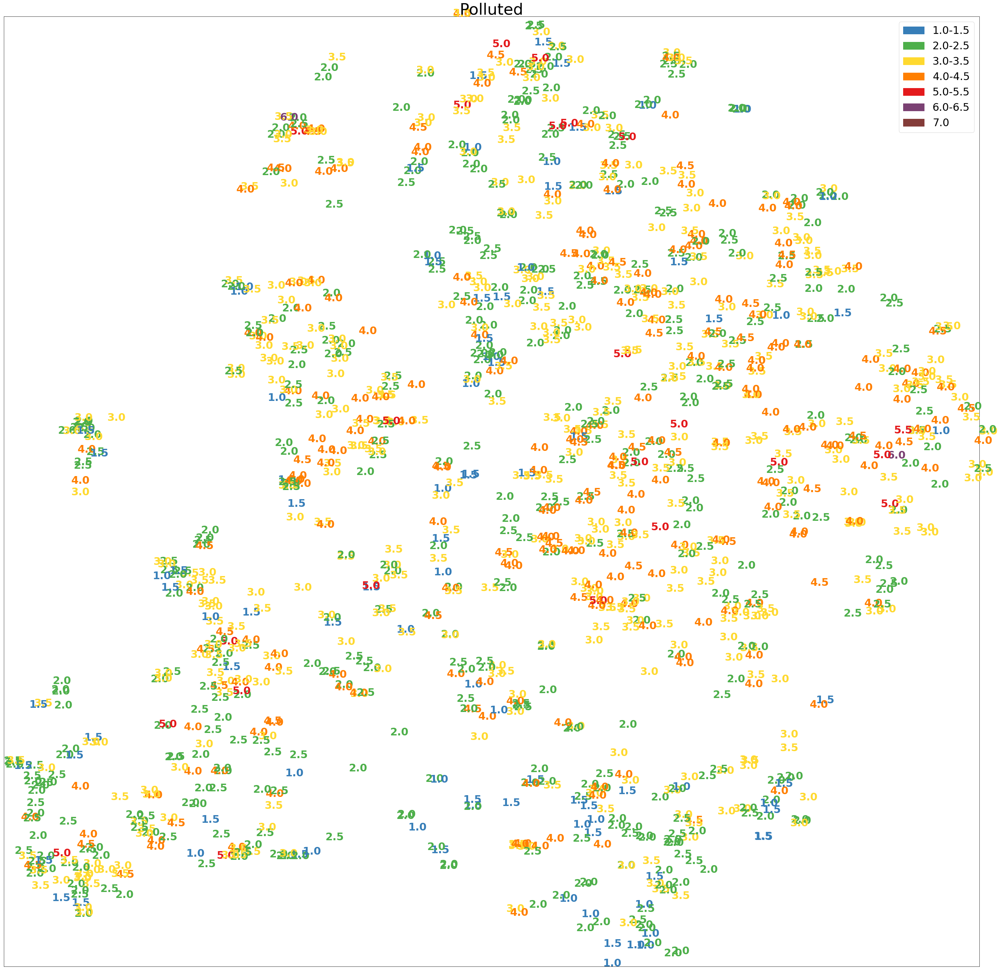

In [9]:
label="Polluted"
plot_embedding(X_tsne,n_samples,df_merge[label],print_pictures=False,print_values=True,plot_title=label)
#plt.show()
plt.savefig('/Users/lemr/Documents/EPFL/Segundo_Semestre/semester_project/scripts/tsne_analysis/tsne_image_segmentation'+label+'_values.jpg')

## Dangerous

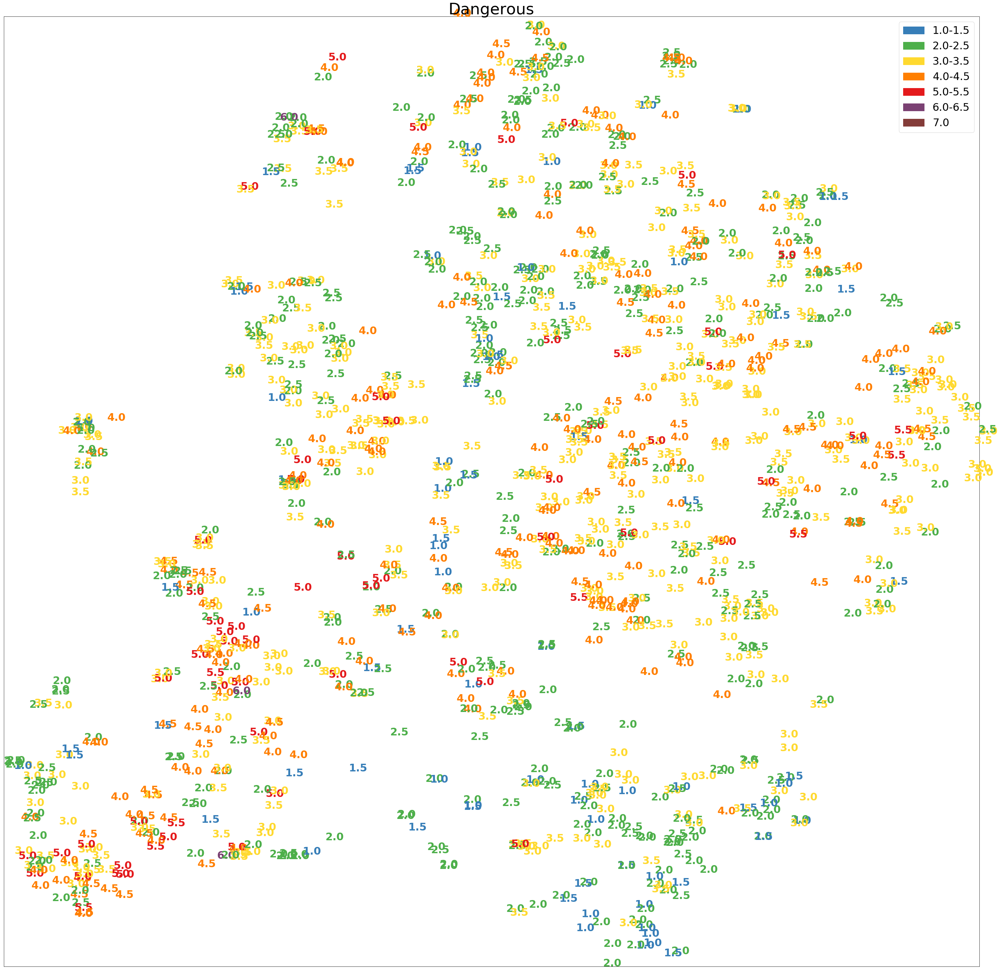

In [10]:
label="Dangerous"
plot_embedding(X_tsne,n_samples,df_merge[label],print_pictures=False,print_values=True,plot_title=label)
#plt.show()
plt.savefig('/Users/lemr/Documents/EPFL/Segundo_Semestre/semester_project/scripts/tsne_analysis/tsne_image_segmentation'+label+'_values.jpg')

## Dirty

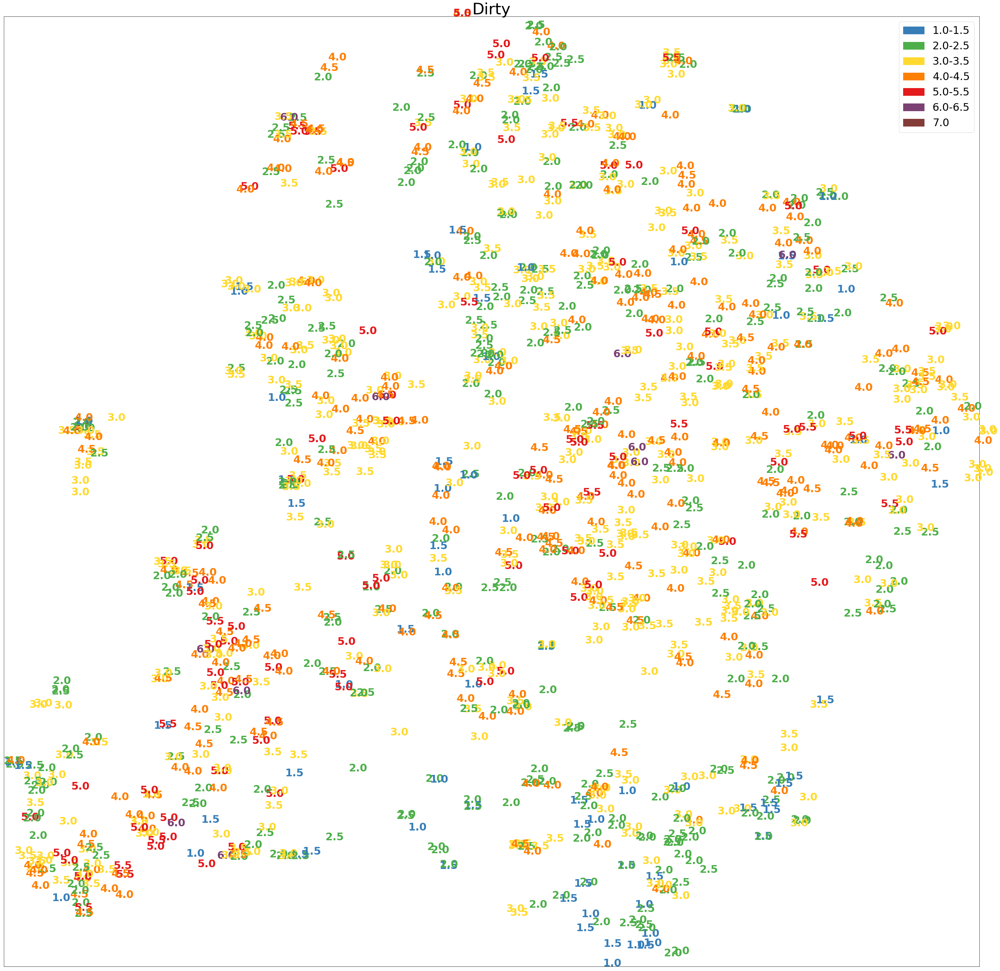

In [11]:
label="Dirty"
plot_embedding(X_tsne,n_samples,df_merge[label],print_pictures=False,print_values=True,plot_title=label)
#plt.show()
plt.savefig('/Users/lemr/Documents/EPFL/Segundo_Semestre/semester_project/scripts/tsne_analysis/tsne_image_segmentation'+label+'_values.jpg')

## Quiet

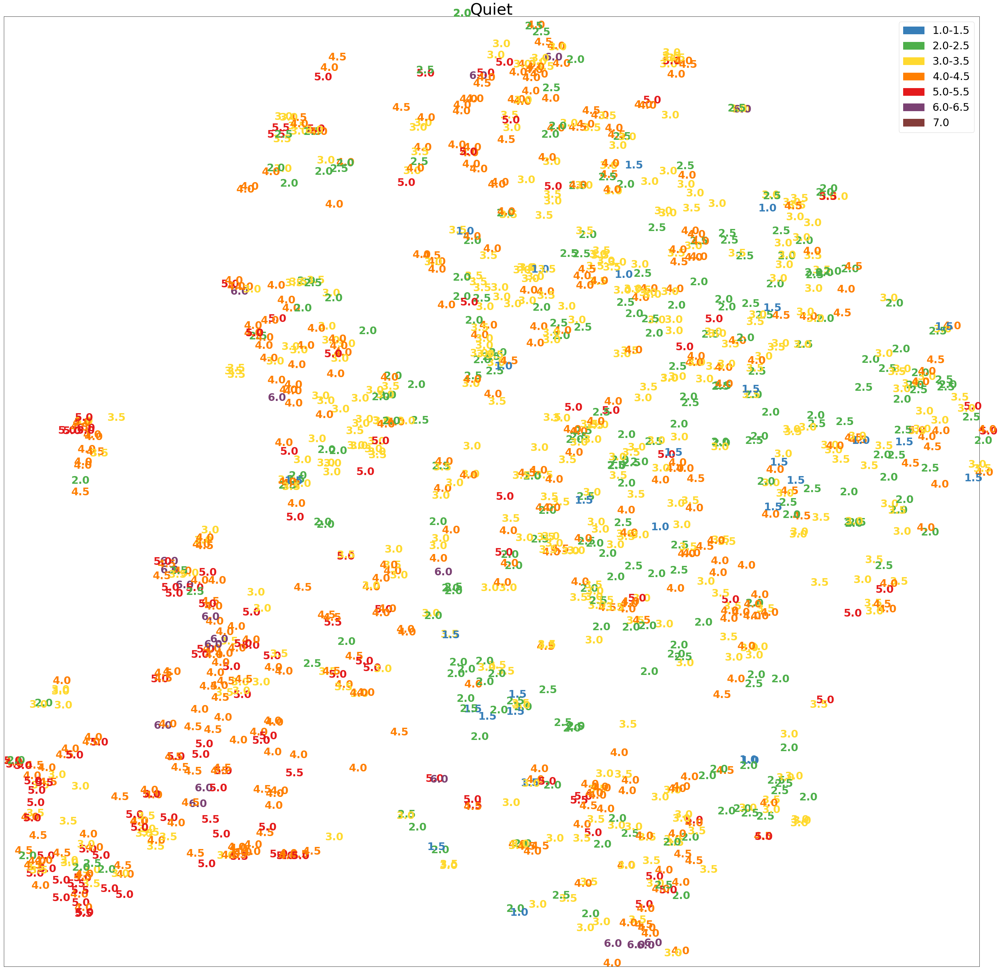

In [12]:
label="Quiet"
plot_embedding(X_tsne,n_samples,df_merge[label],print_pictures=False,print_values=True,plot_title=label)
#plt.show()
plt.savefig('/Users/lemr/Documents/EPFL/Segundo_Semestre/semester_project/scripts/tsne_analysis/tsne_image_segmentation'+label+'_values.jpg')

## Interesting

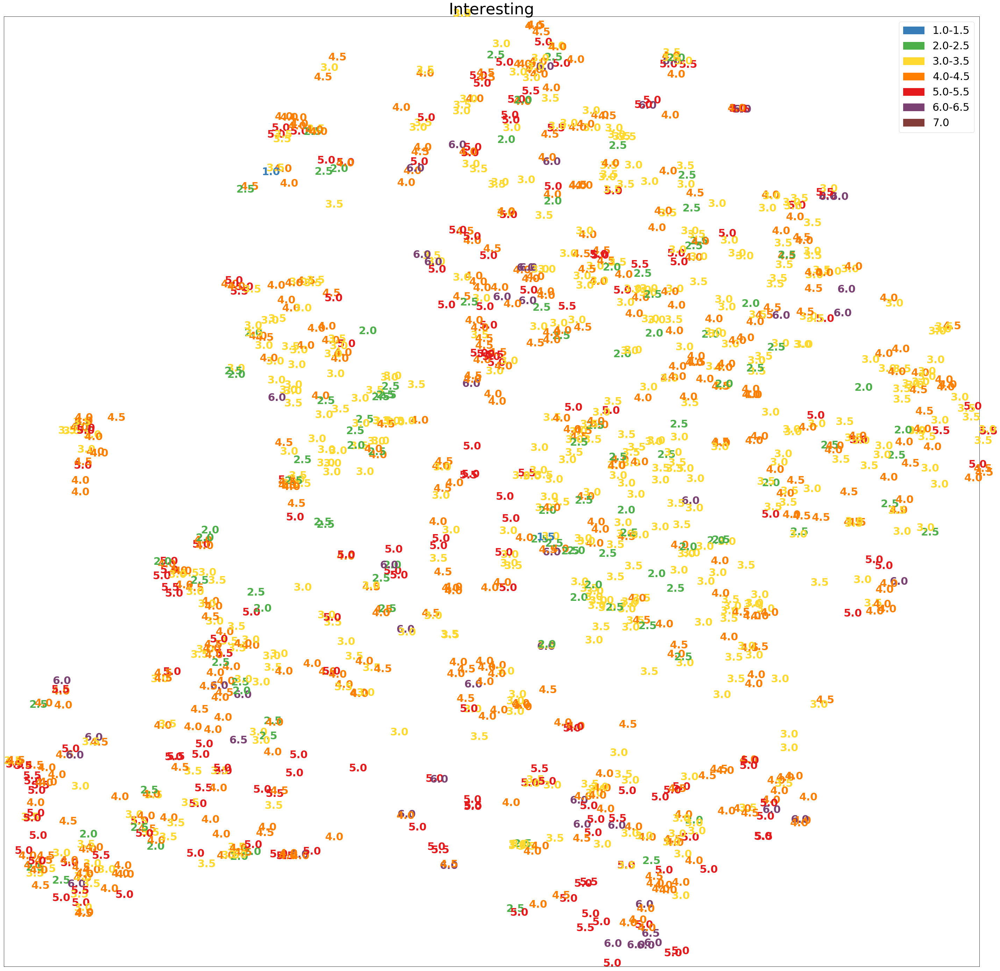

In [13]:
label="Interesting"
plot_embedding(X_tsne,n_samples,df_merge[label],print_pictures=False,print_values=True,plot_title=label)
#plt.show()
plt.savefig('/Users/lemr/Documents/EPFL/Segundo_Semestre/semester_project/scripts/tsne_analysis/tsne_image_segmentation'+label+'_values.jpg')

## Accessible

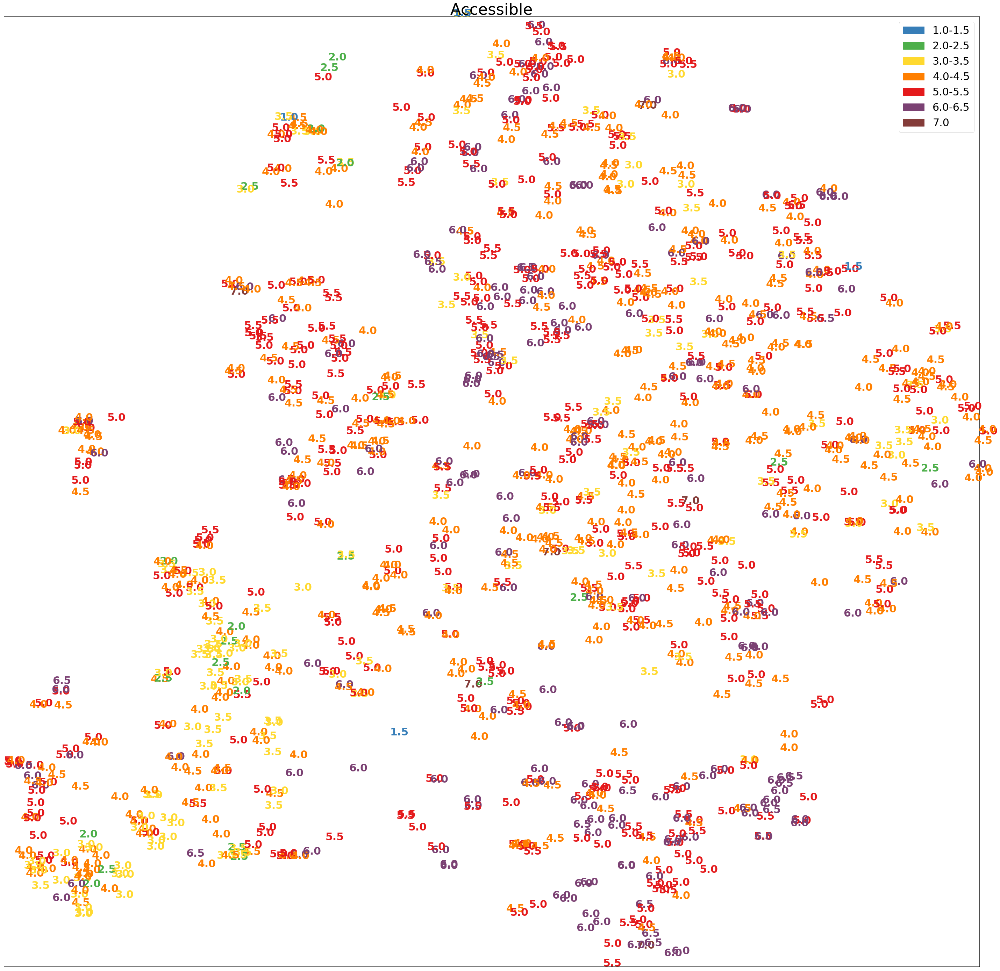

In [14]:
label="Accessible"
plot_embedding(X_tsne,n_samples,df_merge[label],print_pictures=False,print_values=True,plot_title=label)
#plt.show()
plt.savefig('/Users/lemr/Documents/EPFL/Segundo_Semestre/semester_project/scripts/tsne_analysis/tsne_image_segmentation'+label+'_values.jpg')

## Wealthy

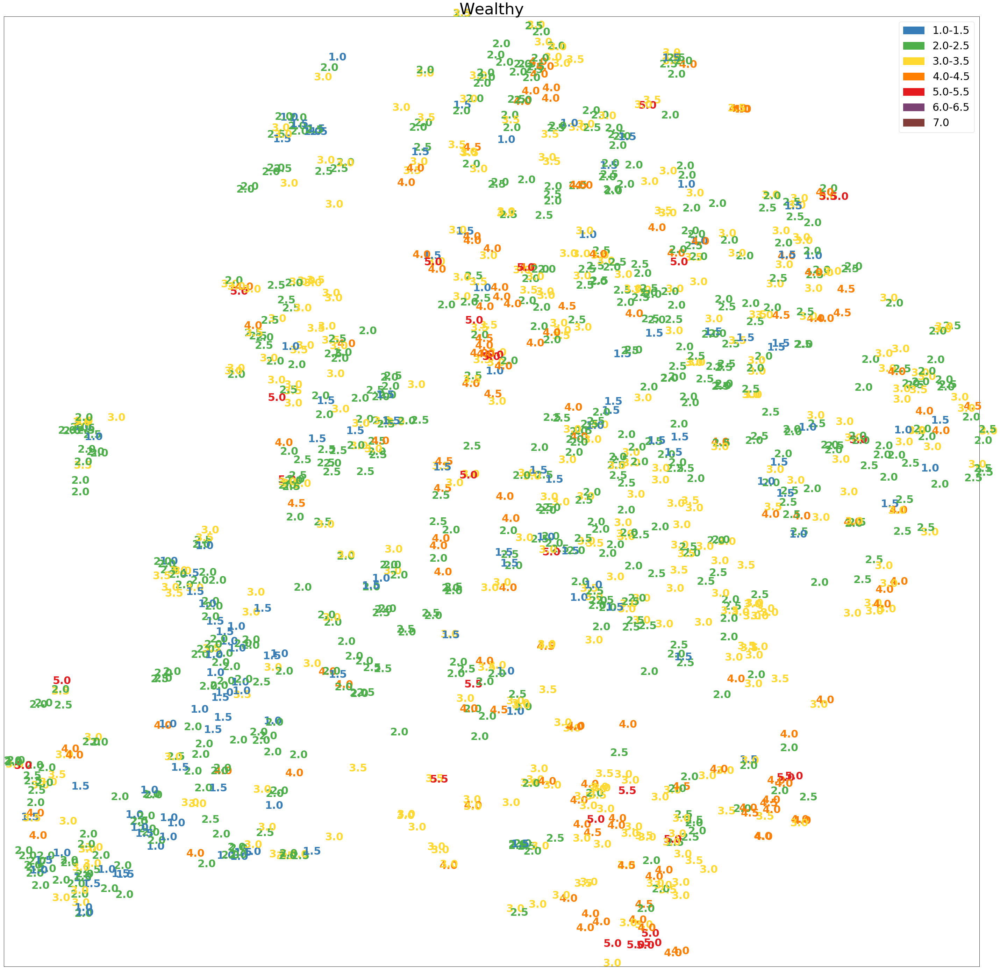

In [15]:
label="Wealthy"
plot_embedding(X_tsne,n_samples,df_merge[label],print_pictures=False,print_values=True,plot_title=label)
#plt.show()
plt.savefig('/Users/lemr/Documents/EPFL/Segundo_Semestre/semester_project/scripts/tsne_analysis/tsne_image_segmentation'+label+'_values.jpg')

## Pretty

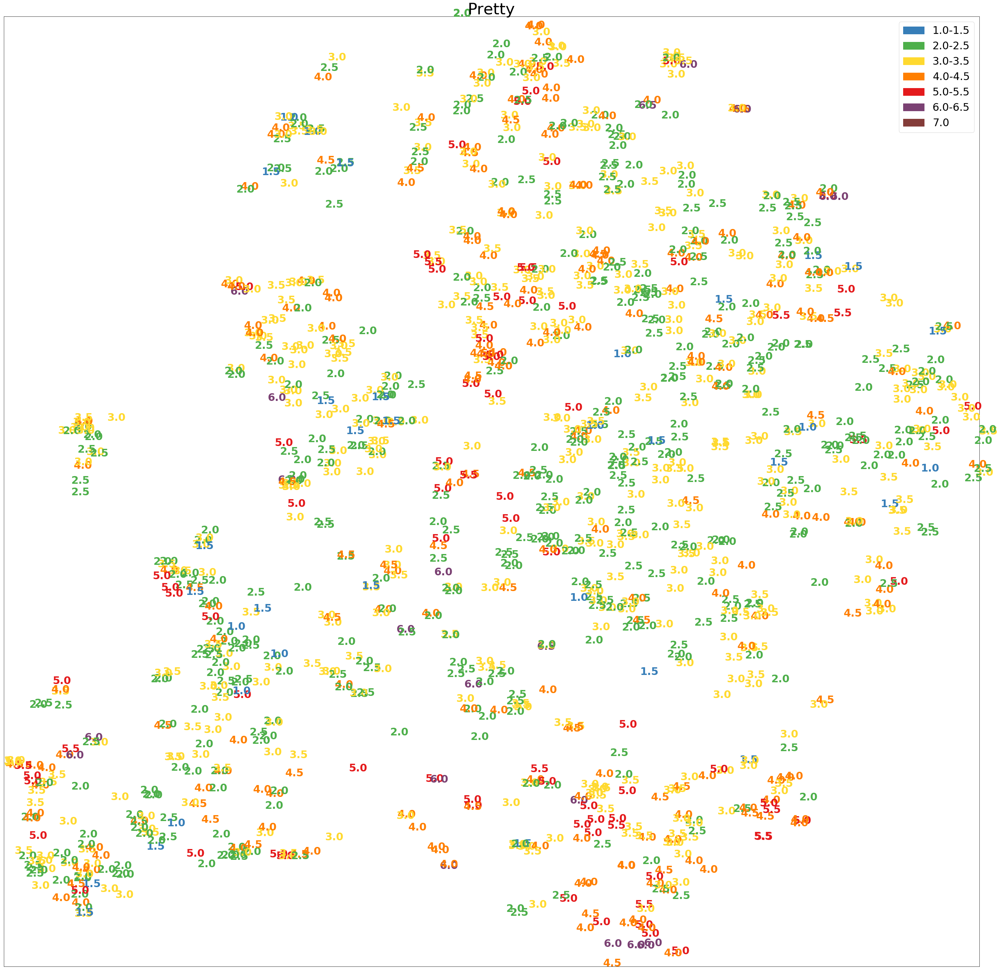

In [16]:
label="Pretty"
plot_embedding(X_tsne,n_samples,df_merge[label],print_pictures=False,print_values=True,plot_title=label)
#plt.show()
plt.savefig('/Users/lemr/Documents/EPFL/Segundo_Semestre/semester_project/scripts/tsne_analysis/tsne_image_segmentation'+label+'_values.jpg')

## Picturesque

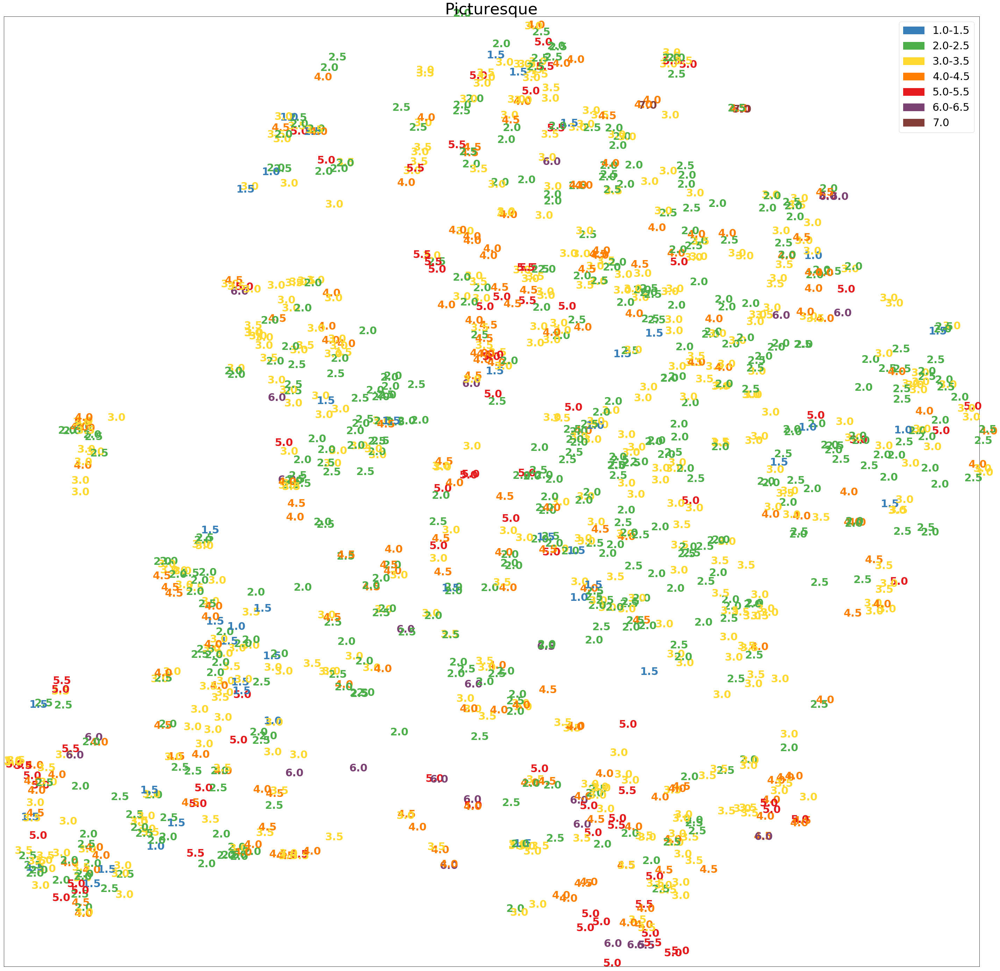

In [17]:
label="Picturesque"
plot_embedding(X_tsne,n_samples,df_merge[label],print_pictures=False,print_values=True,plot_title=label)
#plt.show()
plt.savefig('/Users/lemr/Documents/EPFL/Segundo_Semestre/semester_project/scripts/tsne_analysis/tsne_image_segmentation'+label+'_values.jpg')

## Preserved

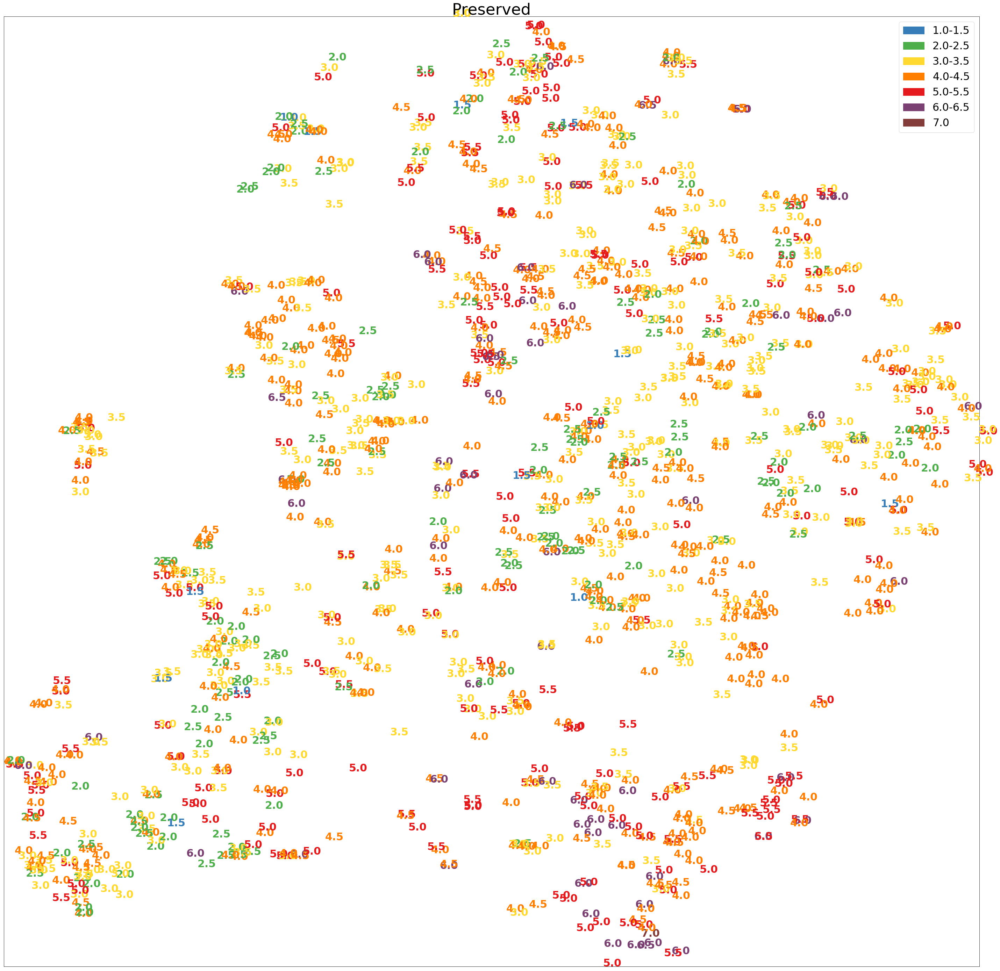

In [18]:
label="Preserved"
plot_embedding(X_tsne,n_samples,df_merge[label],print_pictures=False,print_values=True,plot_title=label)
#plt.show()
plt.savefig('/Users/lemr/Documents/EPFL/Segundo_Semestre/semester_project/scripts/tsne_analysis/tsne_image_segmentation'+label+'_values.jpg')

## Pleasant

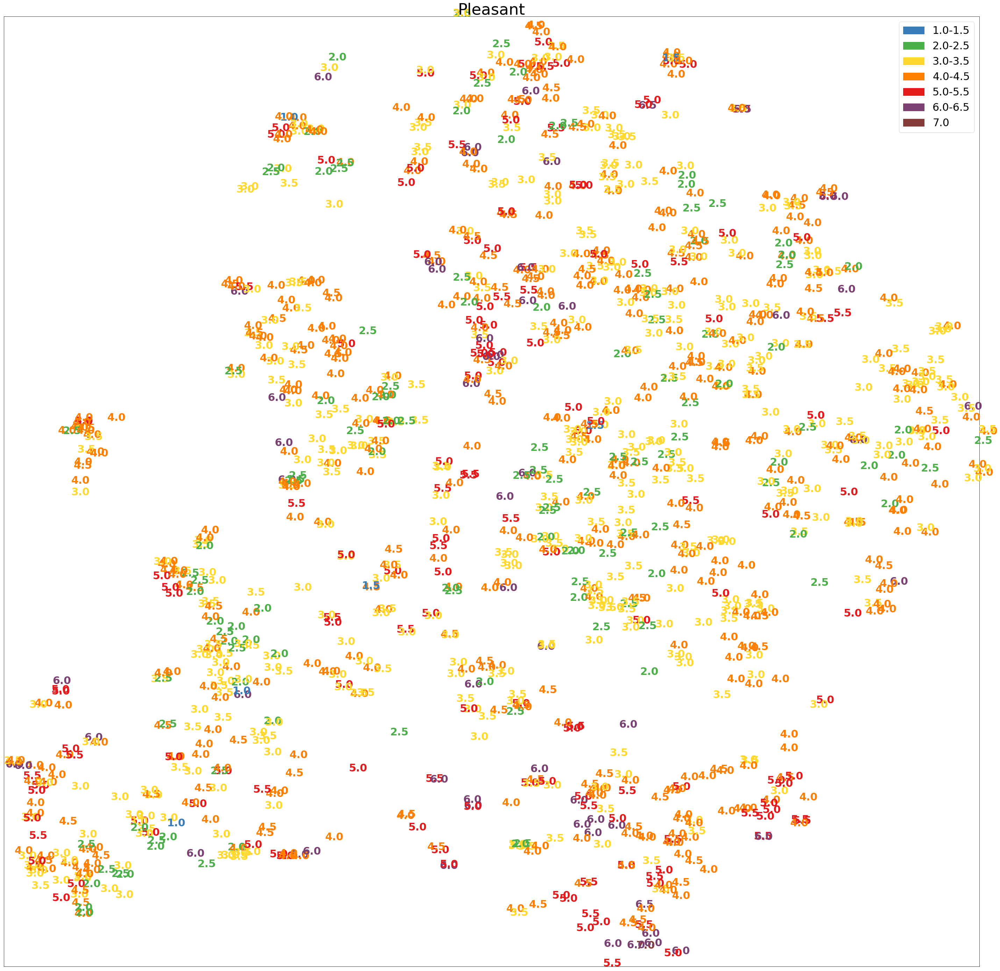

In [19]:
label="Pleasant"
plot_embedding(X_tsne,n_samples,df_merge[label],print_pictures=False,print_values=True,plot_title=label)
#plt.show()
plt.savefig('/Users/lemr/Documents/EPFL/Segundo_Semestre/semester_project/scripts/tsne_analysis/tsne_image_segmentation'+label+'_values.jpg')

## Happy

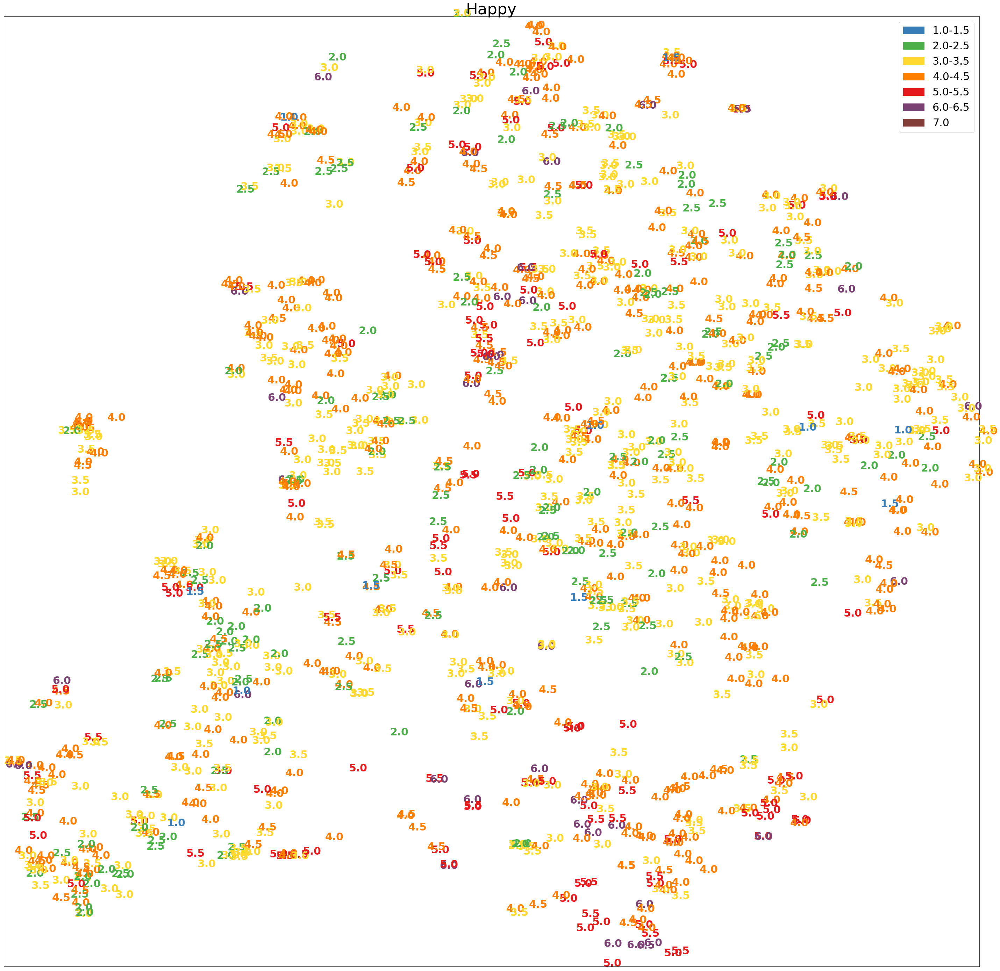

In [20]:
label="Happy"
plot_embedding(X_tsne,n_samples,df_merge[label],print_pictures=False,print_values=True,plot_title=label)
#plt.show()
plt.savefig('/Users/lemr/Documents/EPFL/Segundo_Semestre/semester_project/scripts/tsne_analysis/tsne_image_segmentation'+label+'_values.jpg')

##  <span style="color:red">places205 (205 features)</span> 

In [69]:
#Getting features dataframe
X=pd.read_csv(dir_features_places205).drop(["prob"],axis=1)
n_samples, n_features=X.shape
#Getting labels dataframe
Y=pd.read_csv(dir_labels).drop(["city"],axis=1)
Y=Y.rename(columns = {'annotation':'image'})
labels=Y.columns
labels=labels[labels!="img_id"].tolist()
#Merging both datasets in base to the image file
df_merge=pd.merge(X,Y,on="image")
#Merging the latter with the dataframe with the RGB in order to have the correct order of pictures.
df_pictures=df_pictures.rename(columns = {"img_id":'image'})
df_pictures_order=pd.merge(df_merge,df_pictures,on="image")
#Getting the list of RGB codes with the correct order
RGB_pictures_order=df_pictures_order["RGB"].tolist()

In [46]:
df_merge.head()

,image,feat_places205_1,feat_places205_2,feat_places205_3,feat_places205_4,feat_places205_5,feat_places205_6,feat_places205_7,feat_places205_8,feat_places205_9,...,Pretty,Preserved,Accessible,Interesting,Picturesque,Wealthy,Quiet,Polluted,Pleasant,Happy
0,s_20140101_125134.jpg,0.000100,0.000006,0.877149,0.000044,0.000086,0.000002,0.000048,0.000778,0.000096,...,5.0,5.0,5.0,5.5,4.5,3.5,5.0,2.0,5.0,5.5
1,s_20140101_125419.jpg,0.001102,0.000028,0.294856,0.000114,0.000283,0.000011,0.000479,0.000792,0.000143,...,3.0,4.0,5.0,5.0,3.0,2.5,3.0,2.5,4.0,4.0
2,s_20140101_125819.jpg,0.003951,0.000007,0.023215,0.000105,0.000565,0.000006,0.000772,0.001227,0.000030,...,5.0,6.0,6.0,6.0,5.5,2.0,3.0,2.0,6.0,6.0
3,s_20140101_125835.jpg,0.000294,0.001060,0.074381,0.000237,0.028027,0.000167,0.000605,0.001721,0.000298,...,3.0,4.0,5.0,4.5,2.5,2.0,2.5,3.0,4.0,4.0
4,s_20140101_125939.jpg,0.000827,0.000017,0.765077,0.000071,0.000867,0.000012,0.000655,0.006800,0.000053,...,5.0,5.0,6.0,5.5,5.0,2.5,4.0,2.5,5.5,5.5


##  <span style="color:blue">Plot of the pictures</span> 

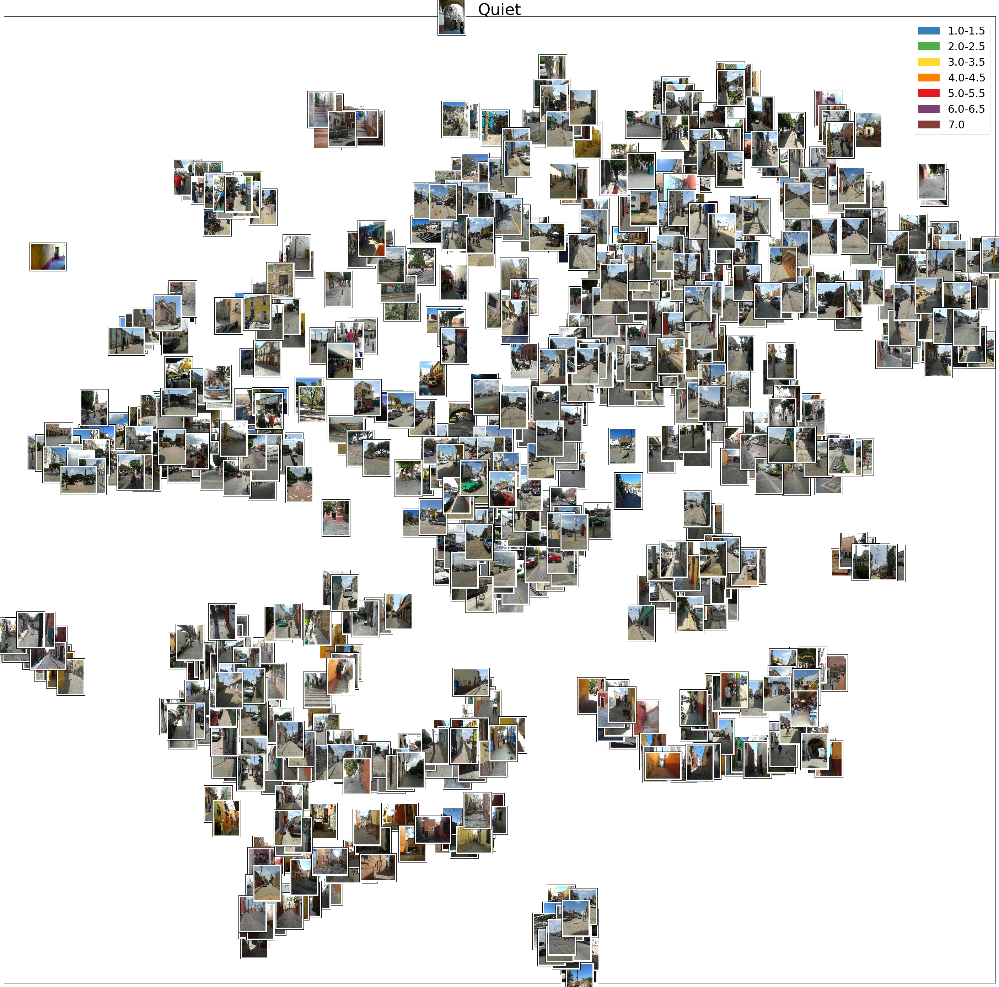

In [71]:
#Since the plot of the position of the different pictures is technically the same between the labels (however, the values will change), we can only plot it once
#Taking one random label to generate the plot with the pictures
label="Quiet"
#Applying TSNE
tsne = TSNE(n_components=2, random_state=0)
X_tsne = tsne.fit_transform(df_merge.drop(labels+["image"],axis=1))
#Getting the plot of the pictures
plot_embedding(X_tsne,n_samples,df_merge[label],print_pictures=True,print_values=False,plot_title=label)
#plt.show()
plt.savefig('/Users/lemr/Documents/EPFL/Segundo_Semestre/semester_project/scripts/tsne_analysis/tsne_places205_pictures.jpg')

## Polluted

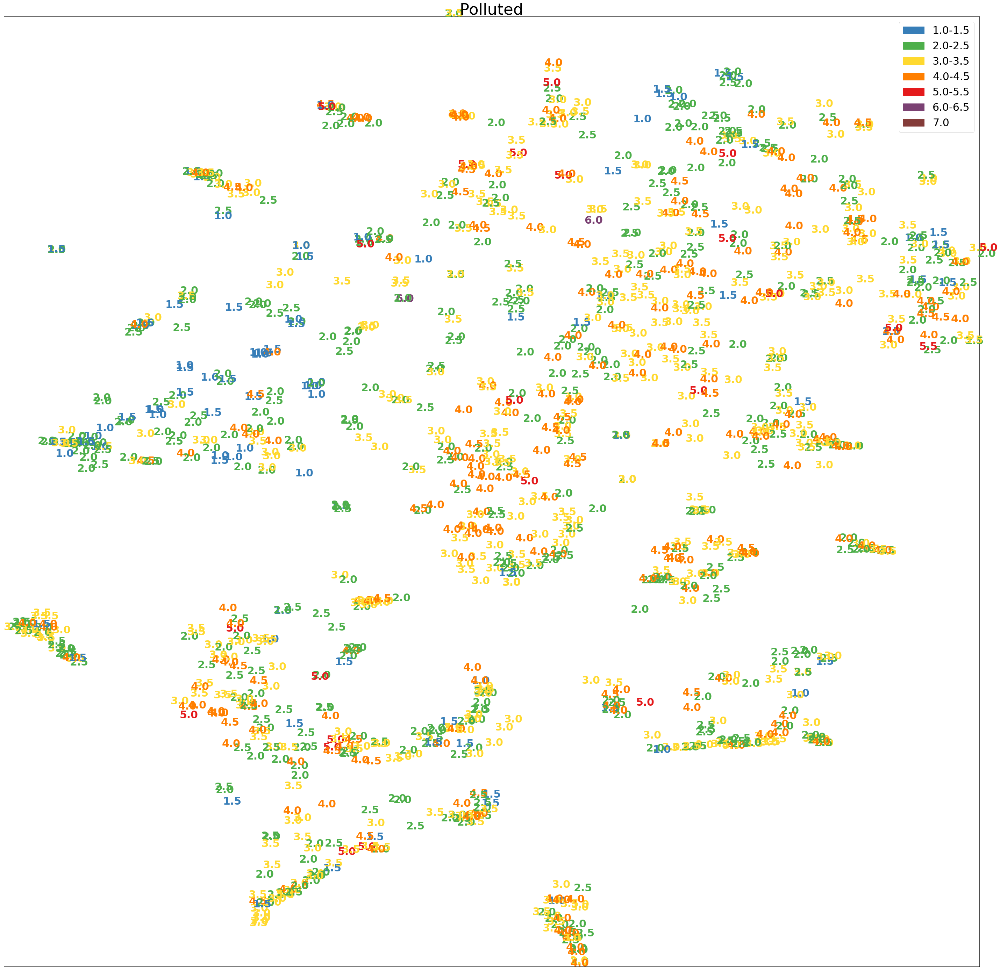

In [24]:
label="Polluted"
plot_embedding(X_tsne,n_samples,df_merge[label],print_pictures=False,print_values=True,plot_title=label)
#plt.show()
plt.savefig('/Users/lemr/Documents/EPFL/Segundo_Semestre/semester_project/scripts/tsne_analysis/tsne_places205_'+label+'_values.jpg')

## Dangerous

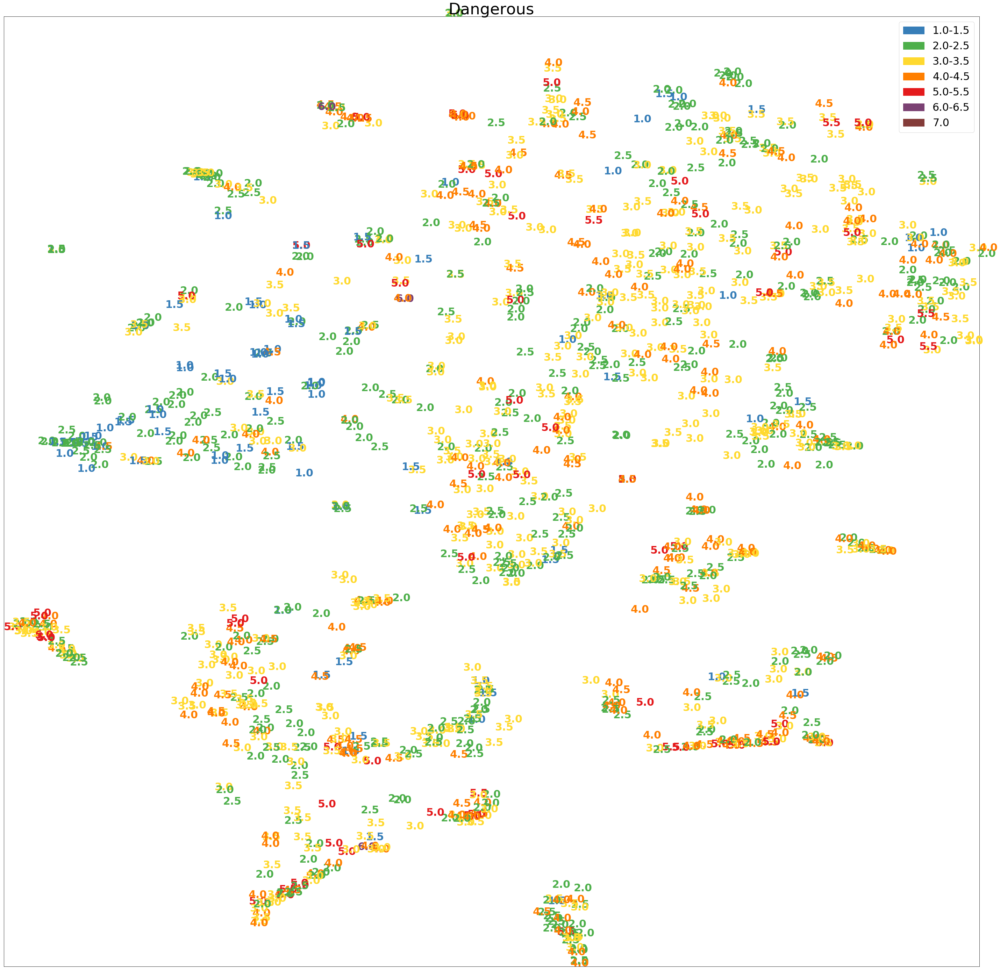

In [25]:
label="Dangerous"
plot_embedding(X_tsne,n_samples,df_merge[label],print_pictures=False,print_values=True,plot_title=label)
#plt.show()
plt.savefig('/Users/lemr/Documents/EPFL/Segundo_Semestre/semester_project/scripts/tsne_analysis/tsne_places205_'+label+'_values.jpg')

## Dirty

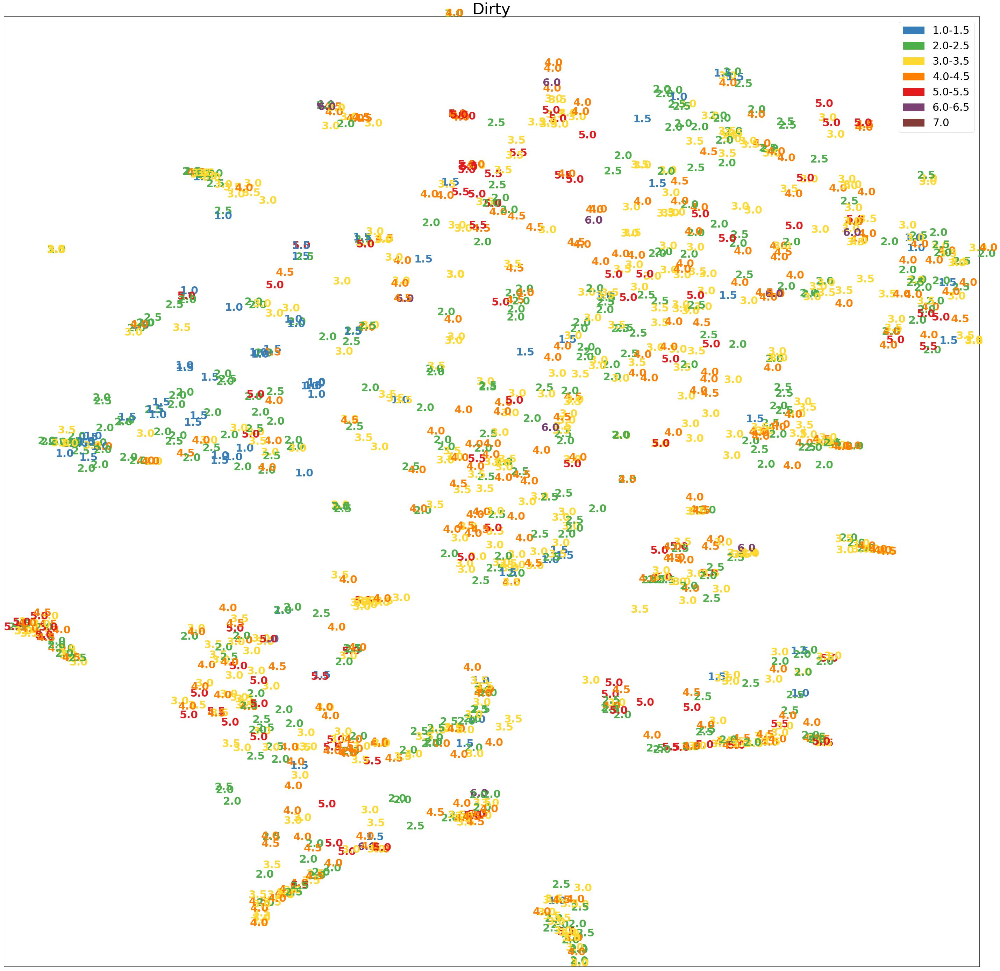

In [26]:
label="Dirty"
plot_embedding(X_tsne,n_samples,df_merge[label],print_pictures=False,print_values=True,plot_title=label)
#plt.show()
plt.savefig('/Users/lemr/Documents/EPFL/Segundo_Semestre/semester_project/scripts/tsne_analysis/tsne_places205_'+label+'_values.jpg')

## Quiet

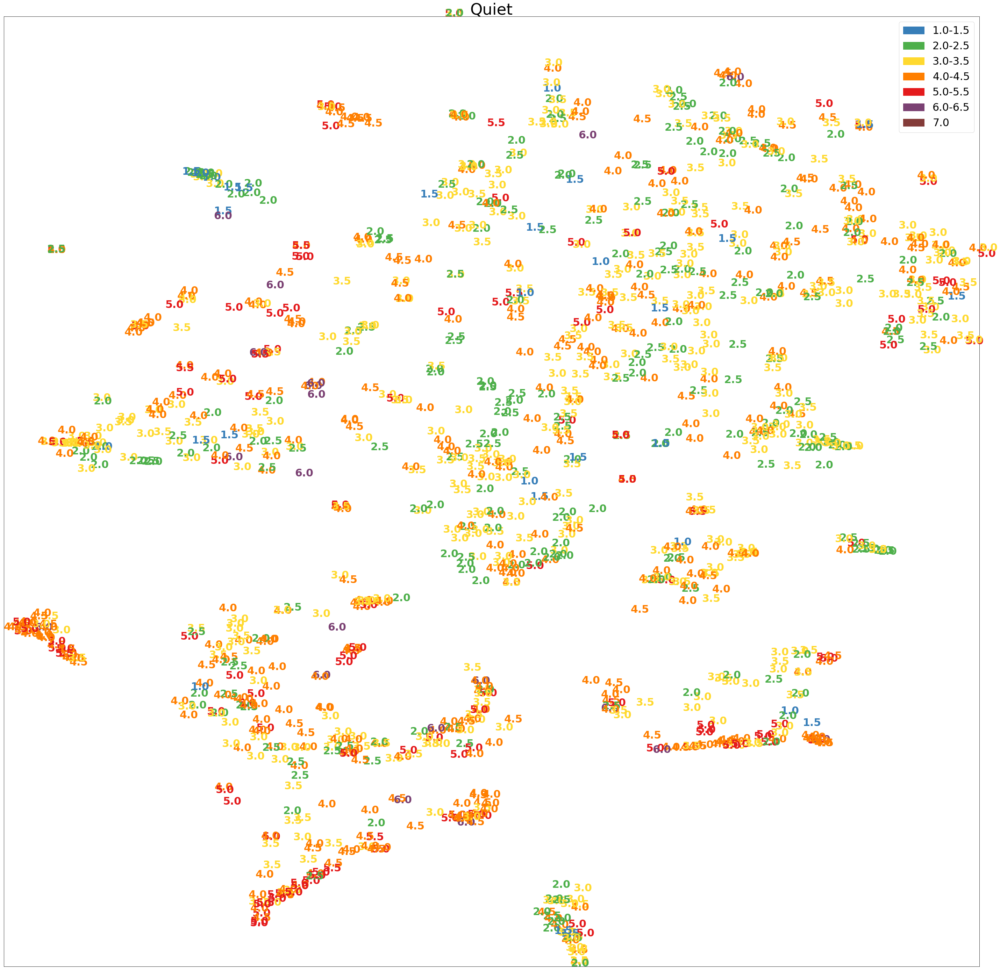

In [27]:
label="Quiet"
plot_embedding(X_tsne,n_samples,df_merge[label],print_pictures=False,print_values=True,plot_title=label)
#plt.show()
plt.savefig('/Users/lemr/Documents/EPFL/Segundo_Semestre/semester_project/scripts/tsne_analysis/tsne_places205_'+label+'_values.jpg')

## Interesting

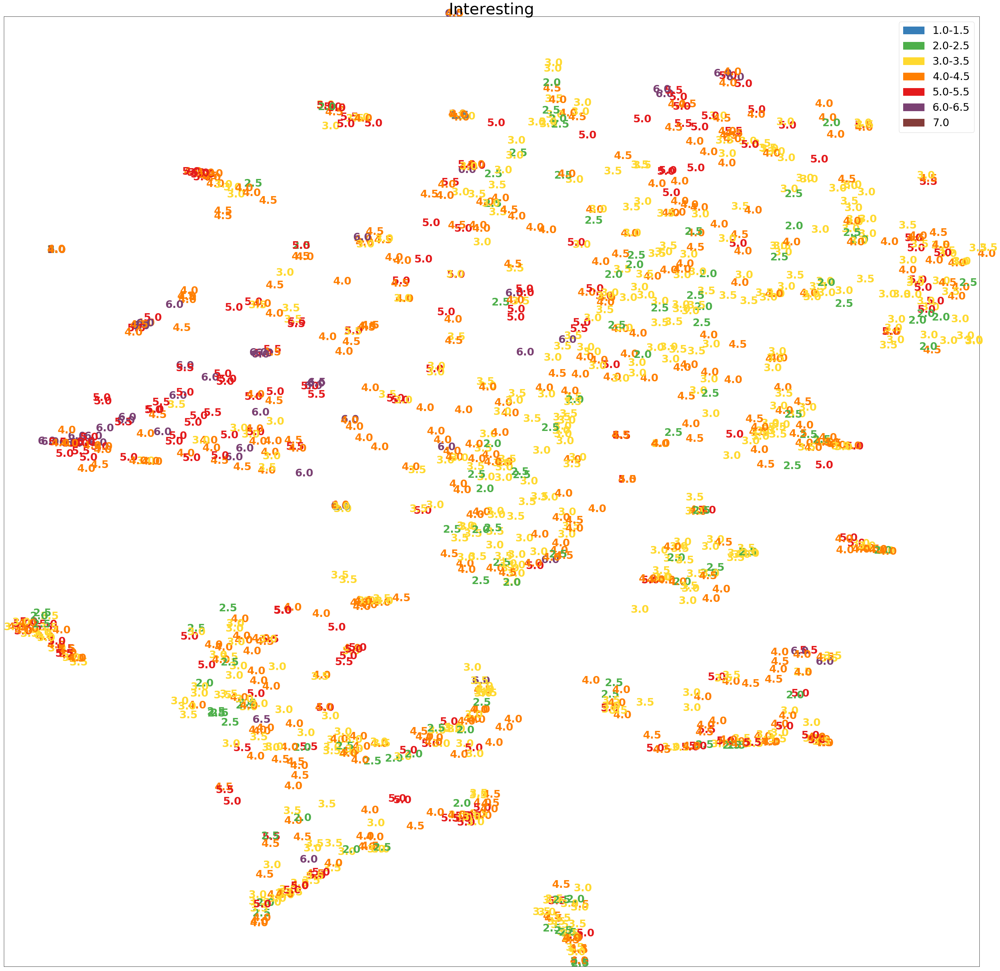

In [28]:
label="Interesting"
plot_embedding(X_tsne,n_samples,df_merge[label],print_pictures=False,print_values=True,plot_title=label)
#plt.show()
plt.savefig('/Users/lemr/Documents/EPFL/Segundo_Semestre/semester_project/scripts/tsne_analysis/tsne_places205_'+label+'_values.jpg')

## Accessible

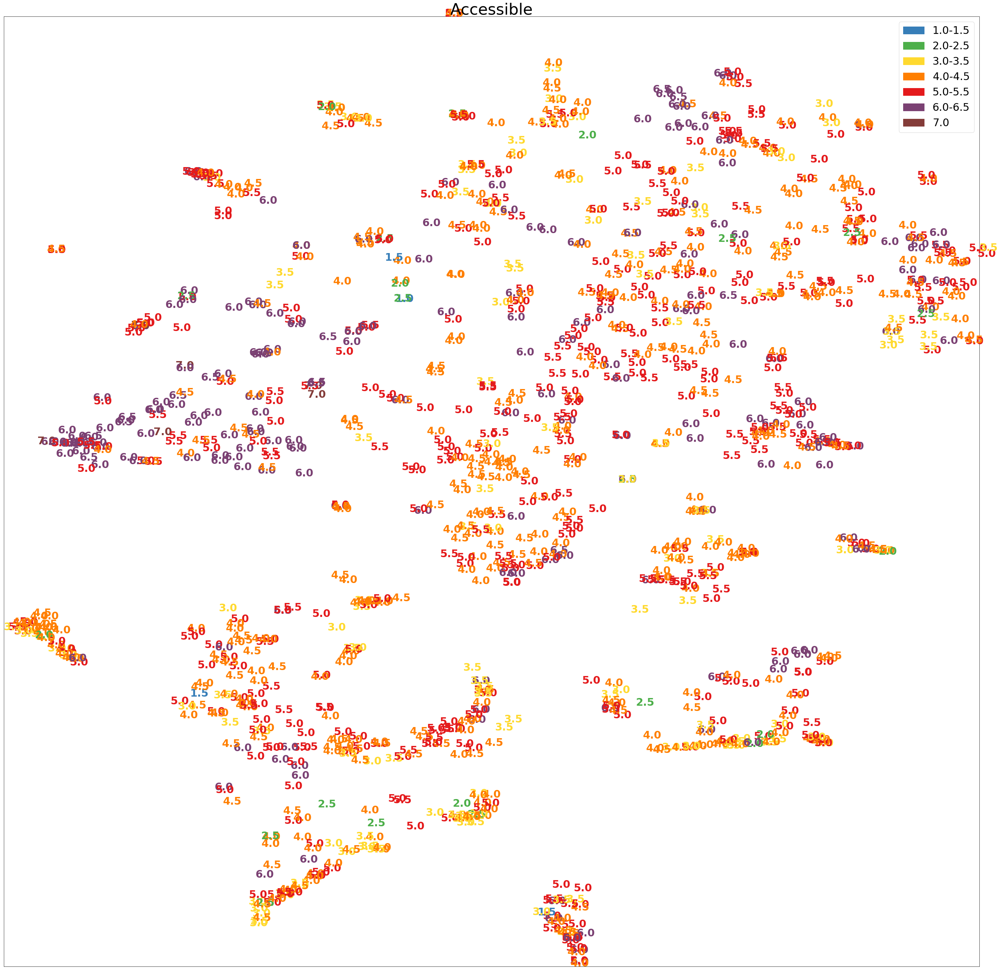

In [29]:
label="Accessible"
plot_embedding(X_tsne,n_samples,df_merge[label],print_pictures=False,print_values=True,plot_title=label)
#plt.show()
plt.savefig('/Users/lemr/Documents/EPFL/Segundo_Semestre/semester_project/scripts/tsne_analysis/tsne_places205_'+label+'_values.jpg')

## Wealthy

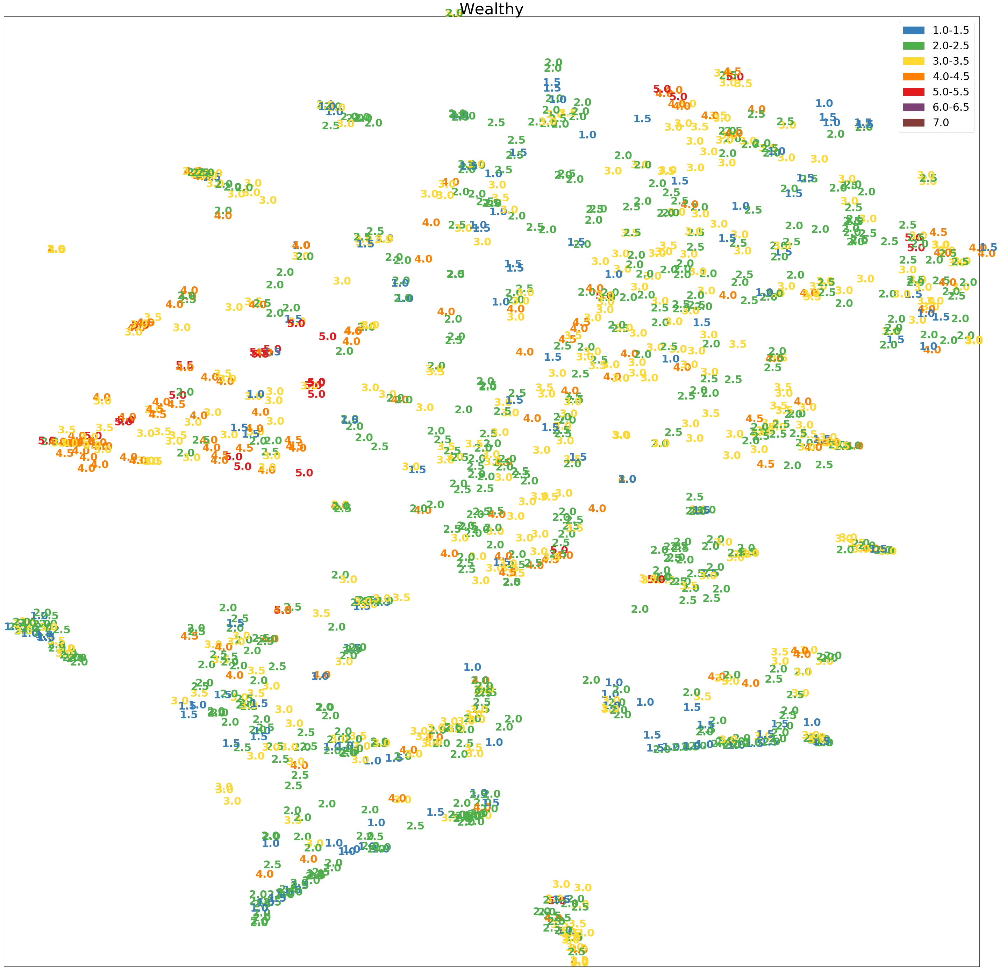

In [30]:
label="Wealthy"
plot_embedding(X_tsne,n_samples,df_merge[label],print_pictures=False,print_values=True,plot_title=label)
#plt.show()
plt.savefig('/Users/lemr/Documents/EPFL/Segundo_Semestre/semester_project/scripts/tsne_analysis/tsne_places205_'+label+'_values.jpg')

## Pretty

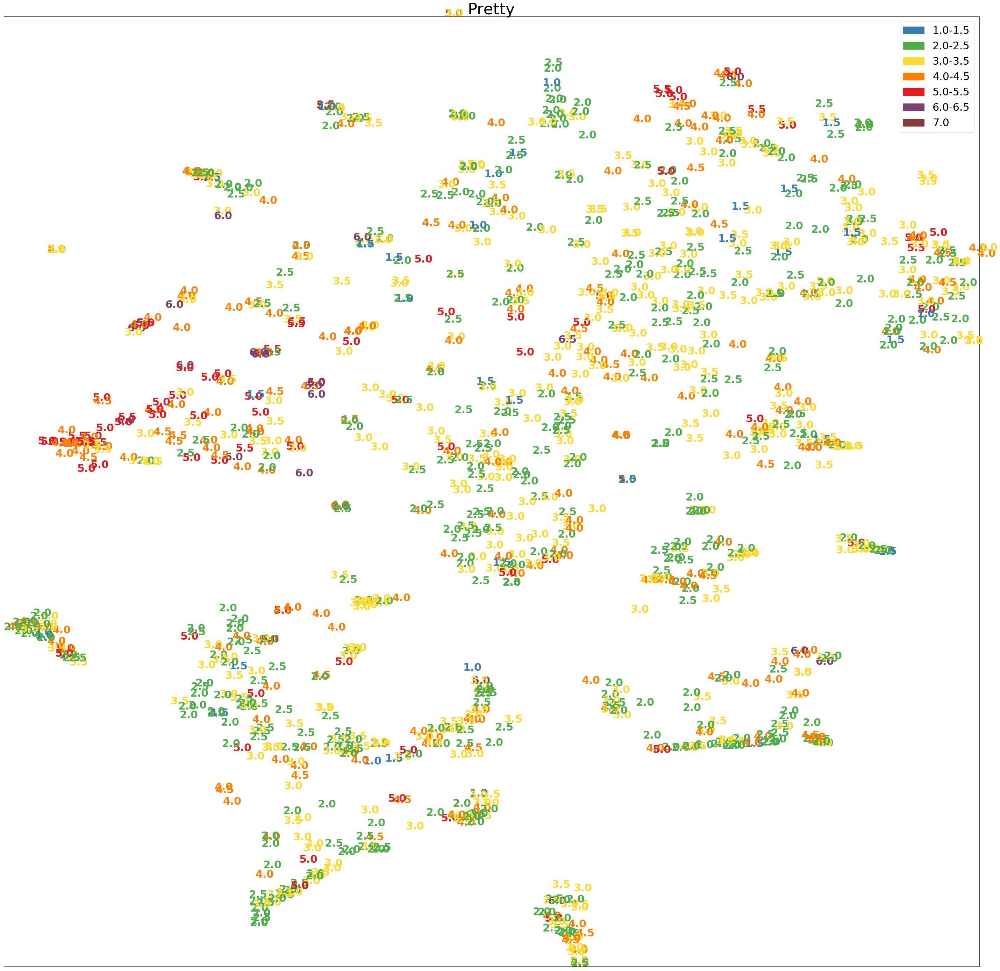

In [31]:
label="Pretty"
plot_embedding(X_tsne,n_samples,df_merge[label],print_pictures=False,print_values=True,plot_title=label)
#plt.show()
plt.savefig('/Users/lemr/Documents/EPFL/Segundo_Semestre/semester_project/scripts/tsne_analysis/tsne_places205_'+label+'_values.jpg')

## Picturesque

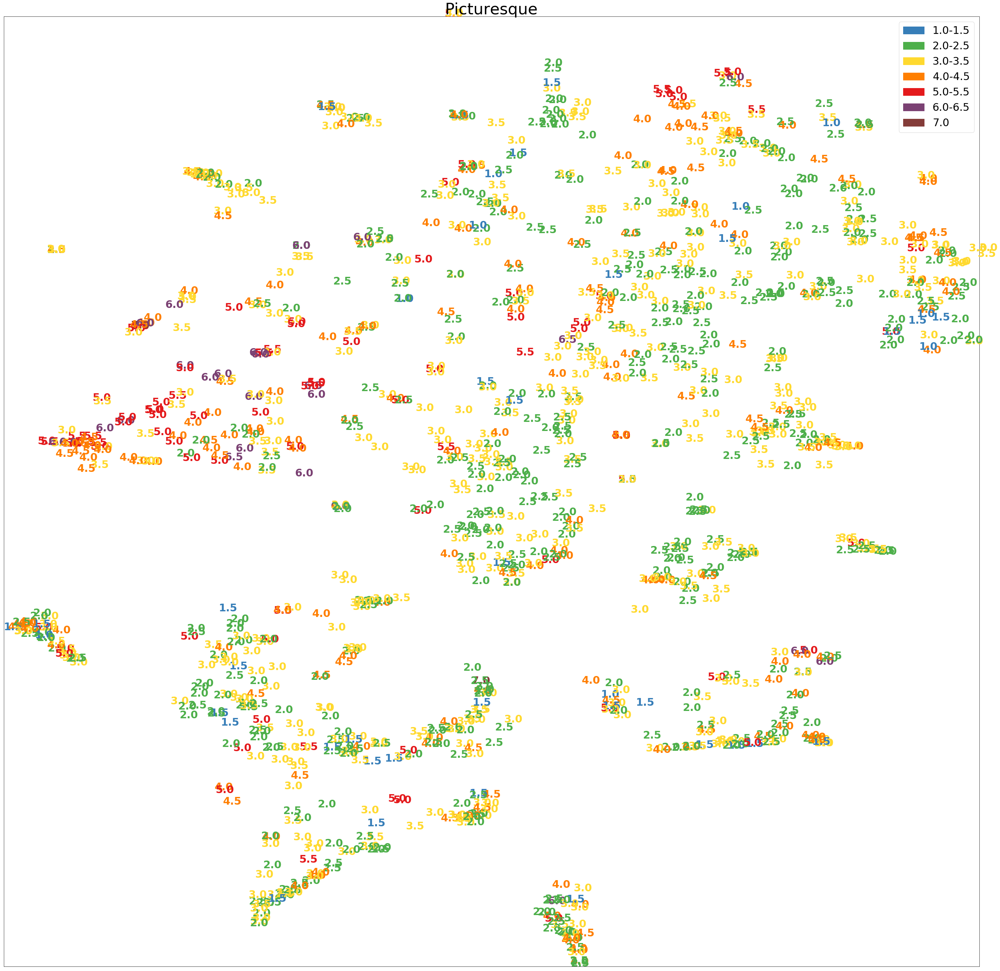

In [32]:
label="Picturesque"
plot_embedding(X_tsne,n_samples,df_merge[label],print_pictures=False,print_values=True,plot_title=label)
#plt.show()
plt.savefig('/Users/lemr/Documents/EPFL/Segundo_Semestre/semester_project/scripts/tsne_analysis/tsne_places205_'+label+'_values.jpg')

## Preserved

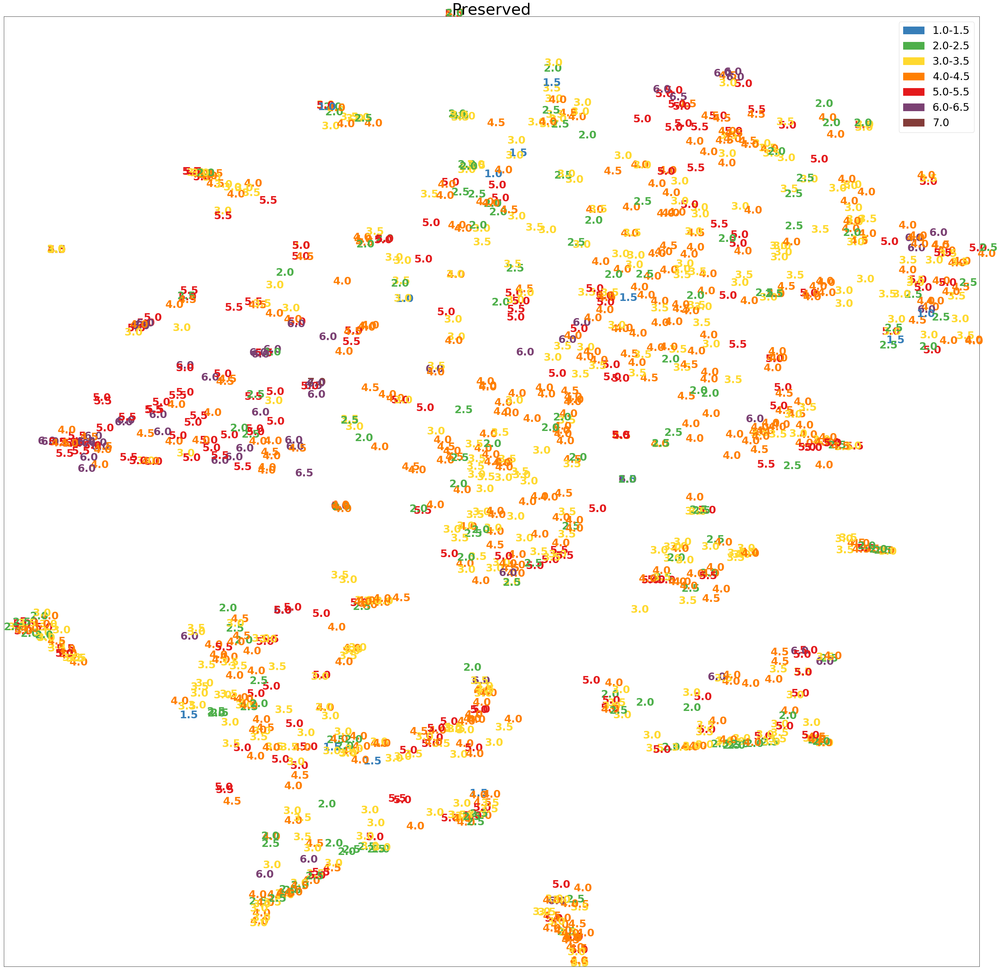

In [33]:
label="Preserved"
plot_embedding(X_tsne,n_samples,df_merge[label],print_pictures=False,print_values=True,plot_title=label)
#plt.show()
plt.savefig('/Users/lemr/Documents/EPFL/Segundo_Semestre/semester_project/scripts/tsne_analysis/tsne_places205_'+label+'_values.jpg')

## Pleasant

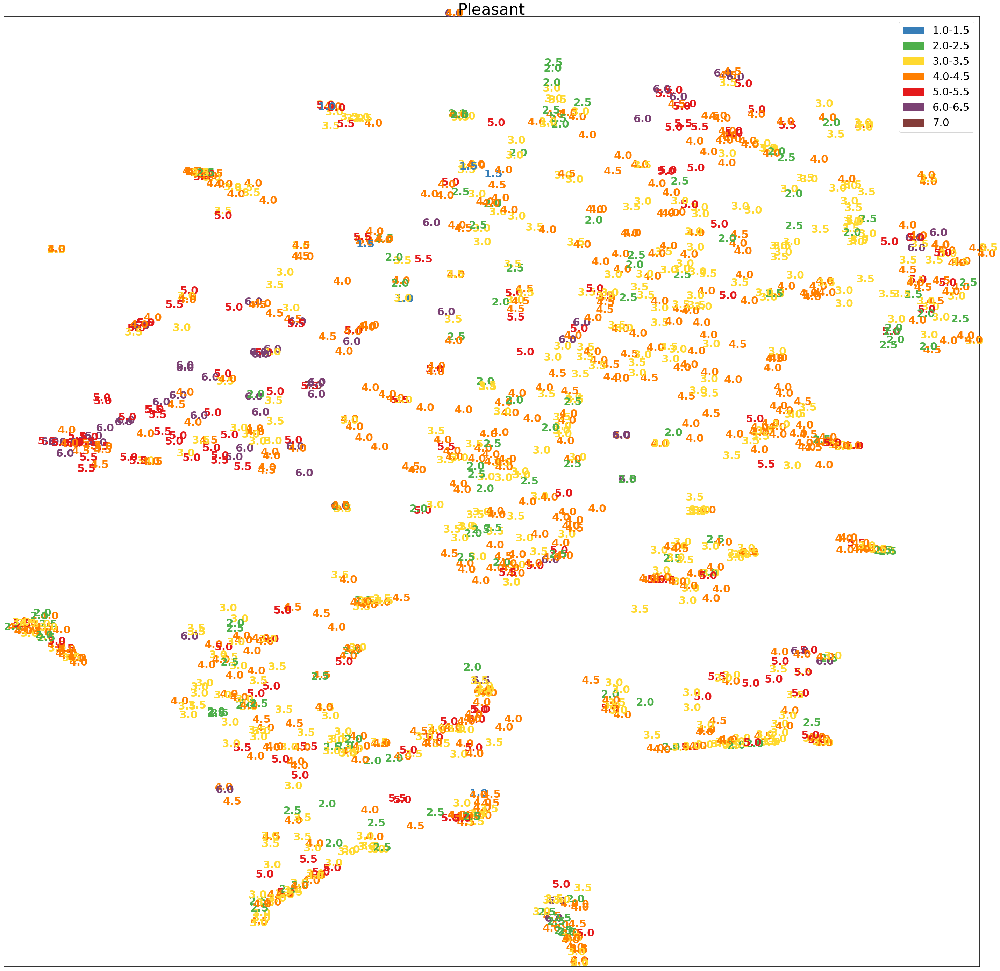

In [34]:
label="Pleasant"
plot_embedding(X_tsne,n_samples,df_merge[label],print_pictures=False,print_values=True,plot_title=label)
#plt.show()
plt.savefig('/Users/lemr/Documents/EPFL/Segundo_Semestre/semester_project/scripts/tsne_analysis/tsne_places205_'+label+'_values.jpg')

## Happy

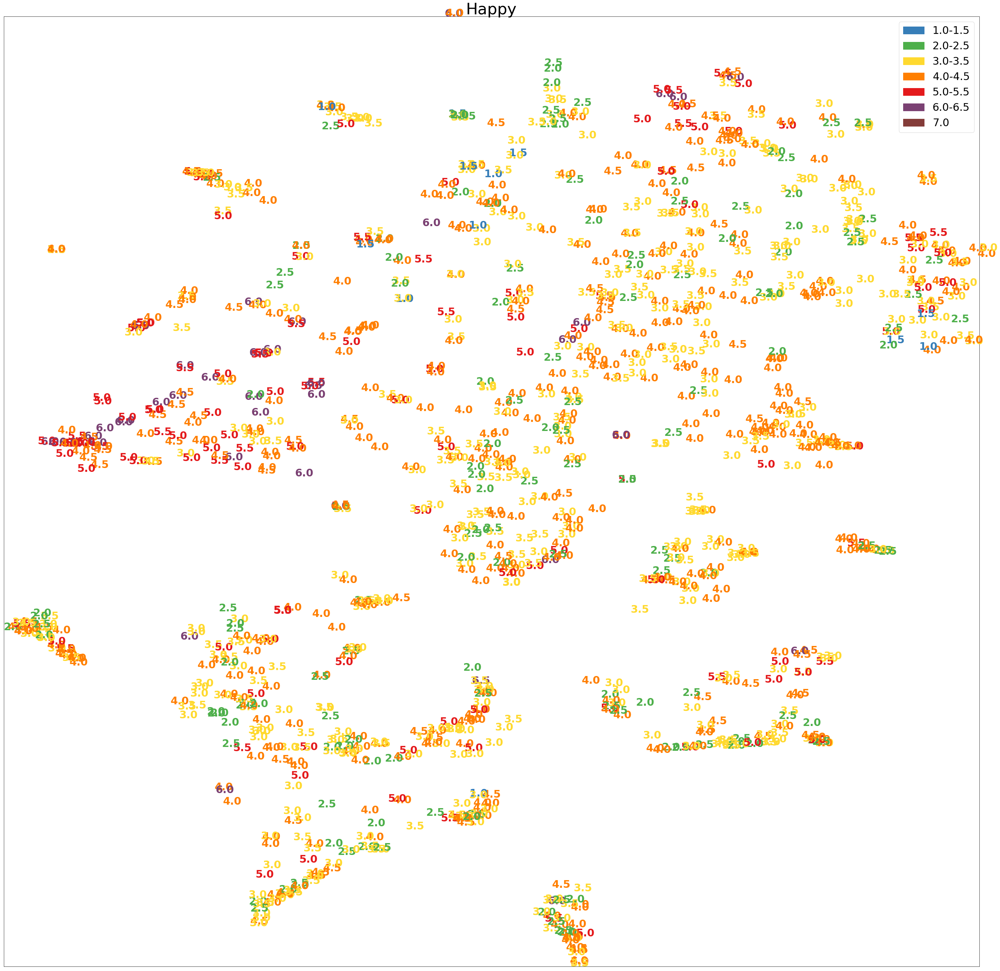

In [35]:
label="Happy"
plot_embedding(X_tsne,n_samples,df_merge[label],print_pictures=False,print_values=True,plot_title=label)
#plt.show()
plt.savefig('/Users/lemr/Documents/EPFL/Segundo_Semestre/semester_project/scripts/tsne_analysis/tsne_places205_'+label+'_values.jpg')